# Big Data and Automated Content Analysis Final Project

# Analysing the lyrics of the greatest hip hop artists of all time

Lukas Pechacek

11954922

03/06/2022

Damian Trilling

University of Amsterdam

In [1]:
# General packages and dictionary analysis
import os
import numpy as np
import json
import pprint
import glob
import tarfile
import bz2
import urllib.request
import re
import pickle
import csv
import requests
import pandas as pd
from collections import Counter

from nltk.tokenize import TreebankWordTokenizer
import matplotlib.pyplot as plt
import matplotlib.style as style 
import seaborn as sns

# Topic Modeling
import gensim
from gensim import matutils
from gensim.models.ldamodel import LdaModel
from gensim.models.coherencemodel import (
    CoherenceModel)
from gensim import corpora, models
from gensim.corpora import Dictionary
from sklearn.decomposition import LatentDirichletAllocation, TruncatedSVD #LAD algorithm
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer #vectorize the lyrics
from sklearn.model_selection import GridSearchCV #hyperparameter tuning
import pyLDAvis 
import pyLDAvis.sklearn
import pyLDAvis
#vis
import pyLDAvis.gensim_models as gensimvis
import logging
import matplotlib.colors as mcolors
import gensim.corpora as corpora
from gensim.utils import simple_preprocess

#spacy
import spacy
from nltk.corpus import stopwords


# Tokenization
import nltk
from nltk.tokenize import (TreebankWordTokenizer, 
                           WhitespaceTokenizer)
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import (
    CountVectorizer, TfidfVectorizer)
from nltk.tokenize import word_tokenize 
from nltk.stem import WordNetLemmatizer


# For plotting word clouds
%matplotlib inline
from matplotlib import pyplot as plt
from wordcloud import WordCloud
from sklearn import preprocessing


# Natural language processing
import spacy

import ufal.udpipe
from gensim.models import KeyedVectors, Phrases
from gensim.models.phrases import Phraser
from ufal.udpipe import Model, Pipeline

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Lukas\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

# Data collection


The list of artists was retrieved from the website ranker.com. The BeautifulSoup package was used to scrape the top 25 hip hop artists as well as the top 25 hip hop bands. The two lists were then joined together and saved as a text file. Afterwards, the Genius API was used to get the top 90 songs by each artist and the corresponding URLs to the song lyrics. Some artists did not have 90 songs on Genius. A list of these three artists was made and 60 songs per artist on this list were still retrieved. Once again, the BeautifulSoup package was used to scrape the lyrics from the retrieved URLs. Artists that had less than 30 songs on Genius were dropped from the list. Ultimately, 44 artists with 3870 songs were retained for further analysis. After scraping the lyrics all the information, namely the artists name, the song URL for each song and lyrics of each song were saved into a csv file. 


# Exploratory Analysis and preprocessing

Here are my exploratory analyses and preprocessing steps. Please find a more comprehensive summary of these before the topic modelling section.

In [2]:
#importing hip hop artists and lyrics dataframe
hiphopDF = pd.read_csv('hiphopDF.csv')
print(hiphopDF.shape)
hiphopDF.head()

(3870, 3)


,Artist,lyrics,URL
0,Eminem,"I'm beginnin' to feel like a Rap God, Rap God\...",https://genius.com/Eminem-rap-god-lyrics
1,Eminem,"You fuckin'—oh\r\nAnd I'm just playin', Diddy\...",https://genius.com/Eminem-killshot-lyrics
2,Eminem,"Man, stop\r\nLook what I'm plannin', haha",https://genius.com/Eminem-godzilla-lyrics
3,Eminem,You better lose yourself in the music\r\nThe m...,https://genius.com/Eminem-lose-yourself-lyrics
4,Eminem,I'm friends with the monster that's under my b...,https://genius.com/Eminem-the-monster-lyrics


In [3]:
pd. set_option('display.max_rows', None) #to get better overview

In [4]:
hiphopDF

,Artist,lyrics,URL
0,Eminem,"I'm beginnin' to feel like a Rap God, Rap God\...",https://genius.com/Eminem-rap-god-lyrics
1,Eminem,"You fuckin'—oh\r\nAnd I'm just playin', Diddy\...",https://genius.com/Eminem-killshot-lyrics
2,Eminem,"Man, stop\r\nLook what I'm plannin', haha",https://genius.com/Eminem-godzilla-lyrics
3,Eminem,You better lose yourself in the music\r\nThe m...,https://genius.com/Eminem-lose-yourself-lyrics
4,Eminem,I'm friends with the monster that's under my b...,https://genius.com/Eminem-the-monster-lyrics
5,Eminem,"So y'all gotta move, yeah, y'all gotta move, y...",https://genius.com/Eminem-lucky-you-lyrics
6,Eminem,"*Plane crash*\r\nYeah \r\nYo, I'm just gonna w...",https://genius.com/Eminem-the-ringer-lyrics
7,Eminem,"A tisk-it a task-it,\r\nI'll go tit-for-tat wi...",https://genius.com/Eminem-without-me-lyrics
8,Eminem,"I've been a liar, been a thief\r\nBeen a lover...",https://genius.com/Eminem-river-lyrics
9,Eminem,"My tea's gone cold, I'm wondering why I\r\nGot...",https://genius.com/Eminem-stan-lyrics


There are 3870 songs with the attributes of 'Artist', 'lyrics' and the song 'url'. First task will be to analyse the data set and get rid of inconsistencies. By inspecting the tail of the data frame it is apparent that there are already some missing values. Some of the first cleaning task include:

- drop missing values
- check dublicates 
- drop duplicates

In [5]:
#Checking for missing values
hiphopDF.isna().sum()

Artist     0
lyrics    86
URL        0
dtype: int64

There are 86 songs with missing lyrics. It does not make sense to keep these for further analyses. Therefore these rows will be dropped.

In [6]:
#Remooving missing values
hiphopDF.dropna(inplace = True)
hiphopDF.reset_index(inplace = True)

In [7]:
hiphopDF.isna().sum()

index     0
Artist    0
lyrics    0
URL       0
dtype: int64

In [8]:
#checking shape of dataframe
hiphopDF.shape

(3784, 4)

In [9]:
hiphopDF.head()

,index,Artist,lyrics,URL
0,0,Eminem,"I'm beginnin' to feel like a Rap God, Rap God\...",https://genius.com/Eminem-rap-god-lyrics
1,1,Eminem,"You fuckin'—oh\r\nAnd I'm just playin', Diddy\...",https://genius.com/Eminem-killshot-lyrics
2,2,Eminem,"Man, stop\r\nLook what I'm plannin', haha",https://genius.com/Eminem-godzilla-lyrics
3,3,Eminem,You better lose yourself in the music\r\nThe m...,https://genius.com/Eminem-lose-yourself-lyrics
4,4,Eminem,I'm friends with the monster that's under my b...,https://genius.com/Eminem-the-monster-lyrics


Inspecting sample lyrics:
seems like the songs do not have paragraphs but multiple lines as sentences.

In [10]:
#inspecting the lyrics
hiphopDF.loc[0, 'lyrics']

'I\'m beginnin\' to feel like a Rap God, Rap God\r\nAll my people from the front to the back nod, back nod\r\nThe way I\'m racin\' around the track, call me NASCAR, NASCAR\r\nDale Earnhardt of the trailer park, the White Trash God\r\nKneel before General Zod\r\nThis planet\'s Krypton—no, Asgard, Asgard\r\nSo you\'ll be Thor and I\'ll be Odin\r\nYou rodent, I\'m omnipotent\r\nLet off, then I\'m reloadin\'\r\nImmediately with these bombs I\'m totin\'\r\nAnd I should not be woken\r\nI\'m the walkin\' dead, but I\'m just a talkin\' head, a zombie floatin\'\r\nBut I got your mom deep-throatin\'\r\nI\'m out my Ramen Noodle\r\nWe have nothin\' in common, poodle\r\nI\'m a Doberman, pinch yourself in the arm and pay homage, pupil\r\nIt\'s me, my honesty\'s brutal\r\nBut it\'s honestly futile if I don\'t utilize what I do though\r\nFor good at least once in a while\r\nSo I wanna make sure somewhere in this chicken scratch I scribble and doodle enough rhymes\r\nTo maybe try to help get some peopl

In [11]:
#Checking how many songs with lyrics we have after removing missing values
hiphopDF['Artist'].value_counts()

DMX                        90
Wu-Tang Clan               90
De La Soul                 90
Gang Starr                 90
Kid Cudi                   90
Ice Cube                   90
J. Cole                    90
Run–D.M.C.                 90
Logic                      90
2Pac                       90
Snoop Dogg                 90
50 Cent                    90
Dr. Dre                    90
A$AP Rocky                 90
Naughty by Nature          90
Geto Boys                  90
Three 6 Mafia              90
The Roots                  90
Outkast                    90
Fugees                     90
Beastie Boys               90
Nate Dogg                  90
Cypress Hill               90
Nas                        90
Busta Rhymes               90
The Pharcyde               90
Childish Gambino           90
Chance the Rapper          90
Bone Thugs-N-Harmony       90
Eminem                     90
Drake                      90
Ghostface Killah           90
A Tribe Called Quest       90
The Notori

Next, duplicates will be dropped based on lyrics column. The rows are first checked for duplicates and put into another dataframe.

In [12]:
df = hiphopDF[hiphopDF.duplicated(['Artist', 'lyrics'])]
df.shape

(18, 4)

In [13]:
#Printing dataframe with duplicates
df

,index,Artist,lyrics,URL
1225,1225,Eazy-E,"Stop him in his tracks, show him that I am Rut...",https://genius.com/Eazy-e-house-party-lyrics
1235,1235,Eazy-E,"So flawless, I'm lawless\r\nRoll out the blue ...",https://genius.com/Eazy-e-down-to-tha-last-roa...
2021,2021,Childish Gambino,Uoy ssim I\r\nUoy tuohtiw ereh m'I yhw wonk t'...,https://genius.com/Childish-gambino-the-longes...
3257,3257,Naughty by Nature,"Oh, you don’t know?\r\nBoom! Bap! Smack! \r\nO...",https://genius.com/Naughty-by-nature-holiday-l...
3436,3436,Boogie Down Productions,Verse Three:\r\nCool like the air we breathe\r...,https://genius.com/Boogie-down-productions-jim...
3464,3464,Boogie Down Productions,If you're listening \r\nThis one here goes out...,https://genius.com/Boogie-down-productions-exh...
3495,3495,Boogie Down Productions,Hook\r\nOutro:\r\nStill gotta give a shoot out...,https://genius.com/Boogie-down-productions-ghe...
3499,3499,Boogie Down Productions,'Cause every time I step to the microphone\r\n...,https://genius.com/Boogie-down-productions-we-...
3515,3515,The Pharcyde,And we’re living in the lifestyle\r\nLiving wi...,https://genius.com/The-pharcyde-otha-fish-lyrics
3519,3519,The Pharcyde,She keeps on passin' me by\r\nShe keeps on pas...,https://genius.com/The-pharcyde-im-that-type-o...


We see 18 rows of duplicates. As such, the original hiphop dataframe will have 18 rows less.

In [14]:
#Dropping duplicates
hiphopDF.drop_duplicates(['Artist', 'lyrics'], inplace=True)

In [15]:
hiphopDF.shape

(3766, 4)

Next, the lyircs themselves will be examined more closely. There may a lot of instrumental songs as Hip Hop artists often put those into their albums. Otherwise it could also be that some songs may not have been scraped correctly, and as such their value remains questionable. It thus makes sense to :
- Create a new column based on word count
- drop those rows that have a non sufficient word count

Afterwards:

- removal of stop words, punctuation. 
    - might have to extend stop words list to include words in lyrics such as 'la', 'ha' etc
- explore artists with most amount of words
- explore artists with most amount of unique words
- lemmatization

https://stackoverflow.com/questions/50821143/pandas-dataframe-count-unique-words-in-a-column-and-return-count-in-another-col

In [16]:
#create a column on the dataframe showing the total number of words for each song
hiphopDF['Word Count'] = hiphopDF['lyrics'].str.split().str.len()## Split list into new series. 

hiphopDF

,index,Artist,lyrics,URL,Word Count
0,0,Eminem,"I'm beginnin' to feel like a Rap God, Rap God\...",https://genius.com/Eminem-rap-god-lyrics,857
1,1,Eminem,"You fuckin'—oh\r\nAnd I'm just playin', Diddy\...",https://genius.com/Eminem-killshot-lyrics,12
2,2,Eminem,"Man, stop\r\nLook what I'm plannin', haha",https://genius.com/Eminem-godzilla-lyrics,7
3,3,Eminem,You better lose yourself in the music\r\nThe m...,https://genius.com/Eminem-lose-yourself-lyrics,88
4,4,Eminem,I'm friends with the monster that's under my b...,https://genius.com/Eminem-the-monster-lyrics,82
5,5,Eminem,"So y'all gotta move, yeah, y'all gotta move, y...",https://genius.com/Eminem-lucky-you-lyrics,52
6,6,Eminem,"*Plane crash*\r\nYeah \r\nYo, I'm just gonna w...",https://genius.com/Eminem-the-ringer-lyrics,1411
7,7,Eminem,"A tisk-it a task-it,\r\nI'll go tit-for-tat wi...",https://genius.com/Eminem-without-me-lyrics,241
8,8,Eminem,"I've been a liar, been a thief\r\nBeen a lover...",https://genius.com/Eminem-river-lyrics,57
9,9,Eminem,"My tea's gone cold, I'm wondering why I\r\nGot...",https://genius.com/Eminem-stan-lyrics,686


In [17]:
hiphopDF['Word Count'].describe()

count    3766.000000
mean      182.478757
std       175.771671
min         0.000000
25%        64.000000
50%       138.000000
75%       248.750000
max      2992.000000
Name: Word Count, dtype: float64

Unfortunately, it seems like a lot of songs have not been scraped correctly and did not return the desired output. From personal knowledge there are indeed some instrumentals. However, also from personal knowledge and inspecting the lyrics more closely, something indeed did not get scraped correctly (I tried the process again but got the same output). For now, songs with less than 25 words will be dropped. I still believe that those with more than 25 can still add value to the analysis.

In [18]:
#using loc method to locate all songs with more than 0 and less than 25 lyrics
indexsongs = hiphopDF.loc[(hiphopDF['Word Count']>0) & (hiphopDF['Word Count'] < 25)].index
hiphopDF.drop(indexsongs , inplace=True)

In [19]:
len(hiphopDF)

3433

In [20]:
#Creating dataframe grouped by lyrics and artitst, and checking values counts as well we sorting them by size.
songsDF = pd.DataFrame(hiphopDF.groupby('Artist')['lyrics'].count().sort_values())
songsDF

,lyrics
Artist,
Eric B. & Rakim,26
N.W.A,44
Boogie Down Productions,73
Run–D.M.C.,74
Three 6 Mafia,76
Cypress Hill,76
Beastie Boys,78
Childish Gambino,78
Naughty by Nature,79


We can see that Ghostface Killah has the most songs, while Eric B. and Rakim have the least amount of songs returned.

- stopword removal

I believe it makes sense to add more words to stop words list that often appear in the lyrics, such as 'uh' 'oh', for instance.

In [21]:
stop_words = stopwords.words('english')
stop_words.extend(('la','la la la la', 'lalala', 're', 'oh oh oh', 'like', 'yeah ah', 'ah yeah', 'laaaa', 'oh', 's', 'uh', 'ah', 'ooooh', 'ohhh', 'yo', 'cha', 
                       'em', 'duh', 'im', 'yeah yeah', 'yeah', 'nigga', 'niggas', 'ai', 'thats', 'ta', 'na', 'pussy', 'dick',  'motherfucker', 'htotheatotheitothettothei',
                  'ge', 'effizzect', 'ladidadada', 'ai', 's', 'nananananana', 'una', 'un', 'el', 'de', 'que', 'get', 'got', 'say', 
                  'do', 'let', 'come', 'tha'))

In [22]:
print(stop_words)

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

Function removing stopwords and punctuation as well as spaces that can occur at the start or end of an article. This function was taken from https://www.youtube.com/watch?v=dtK7Xhn8XjY&t=129s&ab_channel=SolveBusinessProblemsUsingAnalytics and adapted. I do not claim this function as my own.

In [23]:
def process_text(text):
    text = text.lower().replace('\n',' ').replace('\r','').strip() 
    text = re.sub(' +', ' ', text) 
    text = re.sub(r'[^\w\s]','',text) 
    
    
    stop_words = set(stopwords.words('english')) 
    word_tokens = word_tokenize(text) 
    filtered_sentence = [w for w in word_tokens if not w in stop_words] 
    filtered_sentence = [] 
    for w in word_tokens: 
        if w not in stop_words: 
            filtered_sentence.append(w) 
    
    text = " ".join(filtered_sentence)
    return text

Creating a new column with cleaned lyrics

In [24]:
hiphopDF['clean_lyrics'] = hiphopDF['lyrics'].apply(process_text)


Seems like it worked. But there are still words visible such as'im', that should be removed. Therefore, another column is created, based on stop word removal from the already clean_lyrics column.

In [25]:
hiphopDF.head()

,index,Artist,lyrics,URL,Word Count,clean_lyrics
0,0,Eminem,"I'm beginnin' to feel like a Rap God, Rap God\...",https://genius.com/Eminem-rap-god-lyrics,857,im beginnin feel like rap god rap god people f...
3,3,Eminem,You better lose yourself in the music\r\nThe m...,https://genius.com/Eminem-lose-yourself-lyrics,88,better lose music moment better never let go g...
4,4,Eminem,I'm friends with the monster that's under my b...,https://genius.com/Eminem-the-monster-lyrics,82,im friends monster thats bed get along voices ...
5,5,Eminem,"So y'all gotta move, yeah, y'all gotta move, y...",https://genius.com/Eminem-lucky-you-lyrics,52,yall got ta move yeah yall got ta move yeah ya...
6,6,Eminem,"*Plane crash*\r\nYeah \r\nYo, I'm just gonna w...",https://genius.com/Eminem-the-ringer-lyrics,1411,plane crash yeah yo im gon na write first thou...


In [26]:
#Removing more stop words
hiphopDF['clean_lyrics1'] = hiphopDF['clean_lyrics'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop_words)]))

Let's see if it did anything

In [27]:
hiphopDF.head()

,index,Artist,lyrics,URL,Word Count,clean_lyrics,clean_lyrics1
0,0,Eminem,"I'm beginnin' to feel like a Rap God, Rap God\...",https://genius.com/Eminem-rap-god-lyrics,857,im beginnin feel like rap god rap god people f...,beginnin feel rap god rap god people front bac...
3,3,Eminem,You better lose yourself in the music\r\nThe m...,https://genius.com/Eminem-lose-yourself-lyrics,88,better lose music moment better never let go g...,better lose music moment better never go one s...
4,4,Eminem,I'm friends with the monster that's under my b...,https://genius.com/Eminem-the-monster-lyrics,82,im friends monster thats bed get along voices ...,friends monster bed along voices inside head y...
5,5,Eminem,"So y'all gotta move, yeah, y'all gotta move, y...",https://genius.com/Eminem-lucky-you-lyrics,52,yall got ta move yeah yall got ta move yeah ya...,yall move yall move yall move give room give r...
6,6,Eminem,"*Plane crash*\r\nYeah \r\nYo, I'm just gonna w...",https://genius.com/Eminem-the-ringer-lyrics,1411,plane crash yeah yo im gon na write first thou...,plane crash gon write first thoughts see takes...


In [28]:
#Creating a second column with clean lyrics word count
hiphopDF['clean_word_count1'] = hiphopDF['clean_lyrics1'].str.split().str.len()
hiphopDF

,index,Artist,lyrics,URL,Word Count,clean_lyrics,clean_lyrics1,clean_word_count1
0,0,Eminem,"I'm beginnin' to feel like a Rap God, Rap God\...",https://genius.com/Eminem-rap-god-lyrics,857,im beginnin feel like rap god rap god people f...,beginnin feel rap god rap god people front bac...,397
3,3,Eminem,You better lose yourself in the music\r\nThe m...,https://genius.com/Eminem-lose-yourself-lyrics,88,better lose music moment better never let go g...,better lose music moment better never go one s...,35
4,4,Eminem,I'm friends with the monster that's under my b...,https://genius.com/Eminem-the-monster-lyrics,82,im friends monster thats bed get along voices ...,friends monster bed along voices inside head y...,38
5,5,Eminem,"So y'all gotta move, yeah, y'all gotta move, y...",https://genius.com/Eminem-lucky-you-lyrics,52,yall got ta move yeah yall got ta move yeah ya...,yall move yall move yall move give room give r...,24
6,6,Eminem,"*Plane crash*\r\nYeah \r\nYo, I'm just gonna w...",https://genius.com/Eminem-the-ringer-lyrics,1411,plane crash yeah yo im gon na write first thou...,plane crash gon write first thoughts see takes...,692
7,7,Eminem,"A tisk-it a task-it,\r\nI'll go tit-for-tat wi...",https://genius.com/Eminem-without-me-lyrics,241,tiskit taskit ill go titfortat wit anybody who...,tiskit taskit ill go titfortat wit anybody who...,131
8,8,Eminem,"I've been a liar, been a thief\r\nBeen a lover...",https://genius.com/Eminem-river-lyrics,57,ive liar thief lover cheat sins need holy wate...,ive liar thief lover cheat sins need holy wate...,27
9,9,Eminem,"My tea's gone cold, I'm wondering why I\r\nGot...",https://genius.com/Eminem-stan-lyrics,686,teas gone cold im wondering got bed morning ra...,teas gone cold wondering bed morning rain clou...,285
10,10,Eminem,"Venom, adrenaline momentum\r\nAnd I'm not kno...",https://genius.com/Eminem-venom-lyrics,70,venom adrenaline momentum im knowin im ever go...,venom adrenaline momentum knowin ever gon slow...,34
11,11,Eminem,"I'm Slim Shady, yes, I'm the real Shady\r\nAll...",https://genius.com/Eminem-the-real-slim-shady-...,145,im slim shady yes im real shady slim shadys im...,slim shady yes real shady slim shadys imitatin...,85


It seems like removing stop words on the already cleaned lyrics removed further words, such as 'im', visible on row[0]. So it seems for now the clean_lyrics1 column is more suitable.

In [29]:
#trying to remove non english words
hiphopDF[hiphopDF['clean_lyrics1'].map(lambda x: x.isascii())]

,index,Artist,lyrics,URL,Word Count,clean_lyrics,clean_lyrics1,clean_word_count1
0,0,Eminem,"I'm beginnin' to feel like a Rap God, Rap God\...",https://genius.com/Eminem-rap-god-lyrics,857,im beginnin feel like rap god rap god people f...,beginnin feel rap god rap god people front bac...,397
3,3,Eminem,You better lose yourself in the music\r\nThe m...,https://genius.com/Eminem-lose-yourself-lyrics,88,better lose music moment better never let go g...,better lose music moment better never go one s...,35
4,4,Eminem,I'm friends with the monster that's under my b...,https://genius.com/Eminem-the-monster-lyrics,82,im friends monster thats bed get along voices ...,friends monster bed along voices inside head y...,38
5,5,Eminem,"So y'all gotta move, yeah, y'all gotta move, y...",https://genius.com/Eminem-lucky-you-lyrics,52,yall got ta move yeah yall got ta move yeah ya...,yall move yall move yall move give room give r...,24
7,7,Eminem,"A tisk-it a task-it,\r\nI'll go tit-for-tat wi...",https://genius.com/Eminem-without-me-lyrics,241,tiskit taskit ill go titfortat wit anybody who...,tiskit taskit ill go titfortat wit anybody who...,131
8,8,Eminem,"I've been a liar, been a thief\r\nBeen a lover...",https://genius.com/Eminem-river-lyrics,57,ive liar thief lover cheat sins need holy wate...,ive liar thief lover cheat sins need holy wate...,27
9,9,Eminem,"My tea's gone cold, I'm wondering why I\r\nGot...",https://genius.com/Eminem-stan-lyrics,686,teas gone cold im wondering got bed morning ra...,teas gone cold wondering bed morning rain clou...,285
10,10,Eminem,"Venom, adrenaline momentum\r\nAnd I'm not kno...",https://genius.com/Eminem-venom-lyrics,70,venom adrenaline momentum im knowin im ever go...,venom adrenaline momentum knowin ever gon slow...,34
11,11,Eminem,"I'm Slim Shady, yes, I'm the real Shady\r\nAll...",https://genius.com/Eminem-the-real-slim-shady-...,145,im slim shady yes im real shady slim shadys im...,slim shady yes real shady slim shadys imitatin...,85
12,12,Eminem,"Kick your shoes off, let your hair down\r\nAll...",https://genius.com/Eminem-berzerk-lyrics,135,kick shoes let hair night long grow beard weir...,kick shoes hair night long grow beard weird ni...,61


In [30]:
hiphopDF.groupby('Artist')['Word Count'].sum().sort_values()

Artist
Eric B. & Rakim             5736
N.W.A                      11112
Nas                        11253
Beastie Boys               12260
Naughty by Nature          12525
Snoop Dogg                 13221
Kid Cudi                   13270
Mobb Deep                  13462
50 Cent                    13872
Boogie Down Productions    13964
A Tribe Called Quest       14101
Outkast                    14265
Gang Starr                 14288
Childish Gambino           14289
A$AP Rocky                 14329
Ice Cube                   14365
Dr. Dre                    14384
Cypress Hill               14633
J. Cole                    15279
Busta Rhymes               15472
Jay-Z                      15685
Eazy-E                     15695
Geto Boys                  15825
Drake                      16026
Nate Dogg                  16231
De La Soul                 16413
Kanye West                 16530
Wu-Tang Clan               16910
DMX                        17089
Three 6 Mafia              17494
Lil

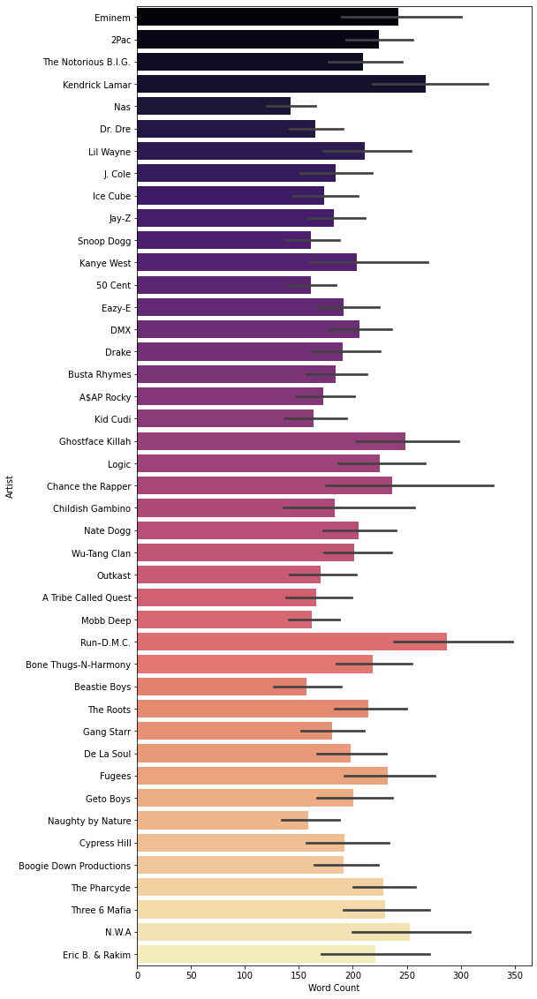

In [31]:
#Word coutn per artist before stop word removal
plt.figure(figsize=[8,20])
sns.barplot(x=hiphopDF['Word Count'], y=hiphopDF['Artist'], palette = 'magma')
plt.show()

Let's see which artists have the most word counts after the stop word removal.

In [32]:
hiphopDF.groupby('Artist')['clean_word_count1'].sum().sort_values()

Artist
Eric B. & Rakim             2976
N.W.A                       5655
Nas                         5668
Beastie Boys                6158
Snoop Dogg                  6582
Naughty by Nature           6643
50 Cent                     6651
Kid Cudi                    6653
Mobb Deep                   6709
Boogie Down Productions     6819
Childish Gambino            6871
Dr. Dre                     7012
A Tribe Called Quest        7027
Ice Cube                    7073
Outkast                     7166
A$AP Rocky                  7203
J. Cole                     7293
Gang Starr                  7343
Eazy-E                      7357
Cypress Hill                7492
Drake                       7644
Busta Rhymes                7767
DMX                         7776
Jay-Z                       7830
Kanye West                  7947
Geto Boys                   7980
Nate Dogg                   8475
Lil Wayne                   8539
De La Soul                  8615
Three 6 Mafia               8659
Log

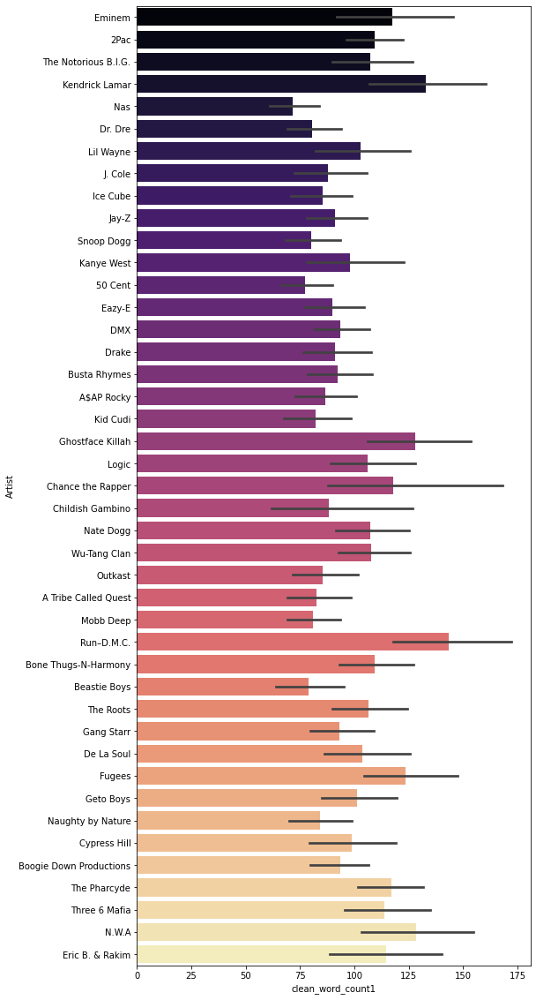

In [33]:
plt.figure(figsize=[8,20])
sns.barplot(x=hiphopDF['clean_word_count1'], y=hiphopDF['Artist'], palette = 'magma')
plt.show()

In [34]:
#Making a dataframe in order to extract the number of unique words per artist
unique_wordsDF = pd.DataFrame(hiphopDF.groupby('Artist')['clean_lyrics1'].sum().sort_values())
unique_wordsDF.reset_index(inplace=True) 
unique_wordsDF.tail()

,Artist,clean_lyrics1
38,A$AP Rocky,swear famous shit happened overnight sure hoes...
39,Jay-Z,take home need whatwhat need take home need wh...
40,J. Cole,turn hoes turn bad thing bout star burn turn h...
41,Kanye West,wanted know loved better kin start dont blame ...
42,Chance the Rapper,yep igh igh igh suspended ooh suspended chiefi...


In [35]:
len(unique_wordsDF.iat[42, 1])

58508

In [36]:
#Creating a set of unique words
unique_words = set()
unique_wordsDF['clean_lyrics1'].str.lower().str.split().apply(unique_words.update)
print(unique_words)

{'equality', 'ghettoknow', 'moons', 'paints', 'mizzy', 'rewarded', 'laker', 'bikinis', 'baisley', 'pleading', 'slinger', 'gegi', 'buttermilk', 'ignored', 'llollipop', 'shouldve', 'distributors', 'seoul', 'shotsmelman', 'dreback', 'tin', 'soup', 'volia', 'jayjoe', 'retaliatesend', 'tinseltown', 'assumption', 'keifer', 'claims', 'mandingo', 'facing', 'hehehehehahaha', 'ballad', 'siblings', 'lickity', 'sailin', 'loudso', 'mutts', 'beaver', 'aintsaid', 'lovereal', 'advised', 'decended', 'jughead', 'relocation', 'worm', 'thousandcould', 'estàs', 'cartoons', 'hoarse', 'afro', 'amerika', 'northern', 'zonebitch', 'eyed', 'genuine', 'cleland', 'alcem', 'controlled', 'alivesaid', 'devin', 'degnahc', 'honesta', 'hungry', 'carloads', 'flockin', 'dada', 'protect', 'eastsideamazing', 'harvey', 'glockll', 'holdin', 'rentar', 'roosevelt', 'unto', 'unhooked', 'delicious', 'gavin', 'doornail', 'ctown', 'nerdy', 'transfixed', 'stang', 'jackin', 'yank', 'snaps', 'ejaculated', 'certy', 'luther', 'froot', '

In [37]:
unique_wordsDF['n_unique'] = [len(set(x.split())) for x in unique_wordsDF['clean_lyrics1'].str.lower()]
#for each value in the column, split the string into words and keep the unique value values in set and get the lenght of the set.

In [38]:
unique_wordsDF.groupby('Artist')['n_unique'].sum().sort_values()

Artist
Eric B. & Rakim            1418
50 Cent                    2089
Nas                        2134
Eazy-E                     2169
DMX                        2184
Snoop Dogg                 2221
Childish Gambino           2235
J. Cole                    2294
Dr. Dre                    2336
A$AP Rocky                 2369
Ice Cube                   2402
Drake                      2406
Mobb Deep                  2427
Outkast                    2437
Beastie Boys               2464
Kanye West                 2473
N.W.A                      2490
2Pac                       2494
Boogie Down Productions    2524
Three 6 Mafia              2531
A Tribe Called Quest       2551
Kid Cudi                   2576
Naughty by Nature          2597
Cypress Hill               2635
Jay-Z                      2757
Logic                      2837
Lil Wayne                  2839
The Notorious B.I.G.       2841
Gang Starr                 2865
Run–D.M.C.                 2876
The Pharcyde               2885
B

In [39]:
unique_wordsDF.head()

,Artist,clean_lyrics1,n_unique
0,Geto Boys,aight stab leg chest back mouth haul give moth...,2989
1,50 Cent,aint gon tell nobody aint gon tell nobody gett...,2089
2,N.W.A,alpha omega beginnin without end play ironside...,2490
3,Gang Starr,ask question question remains mcs reign ones g...,2865
4,Kendrick Lamar,babysittin two three shots ima show turn notch...,3675


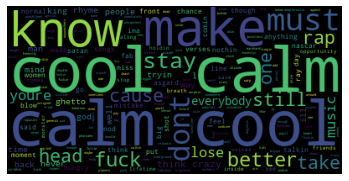

In [40]:
text = hiphopDF['clean_lyrics1'].values 

wordcloud = WordCloud().generate(str(text))

plt.imshow(wordcloud)
plt.axis("off")
plt.show()

In [41]:
##https://www.linkedin.com/pulse/new-way-look-artist-from-lyrics-wordclouds-margot-lepizzera/
#to get a better overview for further preprocessing, the column will be turned into a string
all_lyrics = ""
for index, row in hiphopDF.iterrows():
    lyrics_decoded = row['clean_lyrics1'].lower()
    lyrics_nobacklash = lyrics_decoded.replace("\"", "")
    all_lyrics = all_lyrics + " " + lyrics_nobacklash

In [42]:
all_lyrics

' beginnin feel rap god rap god people front back nod back nod way racin around track call nascar nascar dale earnhardt trailer park white trash god kneel general zod planets kryptonno asgard asgard youll thor ill odin rodent omnipotent reloadin immediately bombs totin woken walkin dead talkin head zombie floatin mom deepthroatin ramen noodle nothin common poodle doberman pinch arm pay homage pupil honestys brutal honestly futile dont utilize though good least wan make sure somewhere chicken scratch scribble doodle enough rhymes maybe try help people tough times keep punchlines case cause even unsigned rappers hungry lookin lunchtime know time king underground still rap pharoahe monch grind crunch rhymes sometimes combine appeal skin color mine big tryin censor one line said back mathers lp 1 tried ill take seven kids columbine put line add ak47 revolver 9 see away aint big morphin immortal comin portal youre stuck time warp 2004 though dont know fuck rhyme youre pointless rapunzel fuc

In [43]:
#https://www.linkedin.com/pulse/new-way-look-artist-from-lyrics-wordclouds-margot-lepizzera/
#identifying 10 most common words

#tokenizing

tok = nltk.tokenize.word_tokenize(all_lyrics)

counter = Counter(tok)
counter.most_common(10)

[('dont', 4052),
 ('know', 3948),
 ('shit', 2805),
 ('aint', 2582),
 ('cause', 2502),
 ('fuck', 2162),
 ('man', 2035),
 ('go', 1909),
 ('one', 1855),
 ('see', 1811)]

It seems like there are still a lot of words that do not indicate many topics. Further preprocessing is needed before starting the analysis. I will also append the stop word list with some of these words such as 'get'and 'got'.

In [44]:
tokens = nltk.tokenize.word_tokenize(all_lyrics)
print(tokens)

['beginnin', 'feel', 'rap', 'god', 'rap', 'god', 'people', 'front', 'back', 'nod', 'back', 'nod', 'way', 'racin', 'around', 'track', 'call', 'nascar', 'nascar', 'dale', 'earnhardt', 'trailer', 'park', 'white', 'trash', 'god', 'kneel', 'general', 'zod', 'planets', 'kryptonno', 'asgard', 'asgard', 'youll', 'thor', 'ill', 'odin', 'rodent', 'omnipotent', 'reloadin', 'immediately', 'bombs', 'totin', 'woken', 'walkin', 'dead', 'talkin', 'head', 'zombie', 'floatin', 'mom', 'deepthroatin', 'ramen', 'noodle', 'nothin', 'common', 'poodle', 'doberman', 'pinch', 'arm', 'pay', 'homage', 'pupil', 'honestys', 'brutal', 'honestly', 'futile', 'dont', 'utilize', 'though', 'good', 'least', 'wan', 'make', 'sure', 'somewhere', 'chicken', 'scratch', 'scribble', 'doodle', 'enough', 'rhymes', 'maybe', 'try', 'help', 'people', 'tough', 'times', 'keep', 'punchlines', 'case', 'cause', 'even', 'unsigned', 'rappers', 'hungry', 'lookin', 'lunchtime', 'know', 'time', 'king', 'underground', 'still', 'rap', 'pharoahe'

In [45]:
len(tokens)

340536

lemmatization, code inspired by - https://www.youtube.com/watch?v=TKjjlp5_r7o&ab_channel=PythonTutorialsforDigitalHumanities

In [46]:
def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']): #words to be included
    nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner']) #disabling parser
    texts_out = [] #creating empty list
    for text in texts: #for each element in the text
        doc = nlp(text) #creating doc object
        new_text = [] #new text list
        for token in doc: #for each token in list
            if token.pos_ in allowed_postags: #if the token in verb, adjective, noun or adverb, append to new_text list
                new_text.append(token.lemma_)
        final = " ".join(new_text)
        texts_out.append(final)
    return (texts_out)

In [47]:
lemm_lyrics = hiphopDF['clean_lyrics1'].values
data_lemma = lemmatization(lemm_lyrics, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'])

In [48]:
print('First item of the lemmatized lyrics by Spacy')
print(data_lemma[0])

First item of the lemmatized lyrics by Spacy
beginnin feel rap god rap people front nod back nod way racin track call nascar nascar dale earnhardt trailer park white trash god kneel general zod planet kryptonno asgard asgard thor ill odin rodent omnipotent reloadin immediately bomb woken walkin dead talkin head zombie floatin mom deepthroatin raman noodle nothin common poodle doberman pinch arm pay homage pupil honesty brutal honestly futile do utilize though good least wan make sure somewhere chicken scratch scribble doodle enough rhyme maybe try help people tough time keep punchline case cause even unsigned rapper hungry lookin lunchtime know time king underground still rap pharoahe monch grind crunch rhyme sometimes combine appeal skin color mine big tryin censor line say back mather lp try ill take kid columbine put line add revolver see away ai big immortal comin portal re stuck time warp though do know fuck rhyme re pointless rapunzel fuckin cornrow write normal fuck normal buy n

In [49]:
#converting strings to list
lyrics_list = [song.split() for song in data_lemma] 


In [50]:
print(lyrics_list)

[['beginnin', 'feel', 'rap', 'god', 'rap', 'people', 'front', 'nod', 'back', 'nod', 'way', 'racin', 'track', 'call', 'nascar', 'nascar', 'dale', 'earnhardt', 'trailer', 'park', 'white', 'trash', 'god', 'kneel', 'general', 'zod', 'planet', 'kryptonno', 'asgard', 'asgard', 'thor', 'ill', 'odin', 'rodent', 'omnipotent', 'reloadin', 'immediately', 'bomb', 'woken', 'walkin', 'dead', 'talkin', 'head', 'zombie', 'floatin', 'mom', 'deepthroatin', 'raman', 'noodle', 'nothin', 'common', 'poodle', 'doberman', 'pinch', 'arm', 'pay', 'homage', 'pupil', 'honesty', 'brutal', 'honestly', 'futile', 'do', 'utilize', 'though', 'good', 'least', 'wan', 'make', 'sure', 'somewhere', 'chicken', 'scratch', 'scribble', 'doodle', 'enough', 'rhyme', 'maybe', 'try', 'help', 'people', 'tough', 'time', 'keep', 'punchline', 'case', 'cause', 'even', 'unsigned', 'rapper', 'hungry', 'lookin', 'lunchtime', 'know', 'time', 'king', 'underground', 'still', 'rap', 'pharoahe', 'monch', 'grind', 'crunch', 'rhyme', 'sometimes',

# To sum up: Exploratory Analyses and preprocessing

Exploratory analyses revealed that before the stop word removal Kendrick Lamar was the artist with the highest word count, while NWA was the artist with the lowest word count out of the artists of which 90 songs could be extracted. Interestingly, after stop word removal, Ghostface Killa became the artist with highest word count. Ghostface Killa and The Fugees were the artists with the highest number of unique words in the lyrics while rapper 50 Cent was the artist with the least number of unique words. 

The csv file was then turned into a Pandas data frame, which consisted of 3870 rows and 3 columns. After checking for missing values, it became clear that the lyrics of 86 songs were not scraped at all. It made no sense to keep those in the dataset and as such were dropped. Next, it was checked whether some songs were duplicated. After inspection 18 rows were dropped as duplicates. A column was then created based on the word count per song. This was to see whether there were some songs with a suspiciously little number of words. This could be due to some songs not having been scraped correctly or some songs only being the instrumental version, and as such not very useful for the analysis. All songs with a word count between 0 and 25 were ultimately dropped from the data set. Anything above a word count of 25 still seemed as if it could add to the analysis. Consequently, the final data set used for the analysis consisted of 3433 songs. The next step of the pre-processing was to remove stopwords from the lyrics. Before this was done the stop word list was appended with a few more items after some inspection of the lyrics. Lyrics such as ‘la’, ‘lalala’, ‘oh’, ‘yeah yeah’ among others were added to the list as these were deemed as unnecessary words for the analysis. Lastly, the lyrics were lemmatized using the spacy lemmatizer to group together inflected forms of a word so they can be analysed as a single item, essentially retaining more words while removing different forms of the same word. Nouns, adjectives, verbs and adverbs were kept for kept for the analysis. 

# Topic Modelling

To model simultaneously which topics are found in the whole corpus of song lyrics, a topic modelling approach with latent Dirichlet Allocation (LDA) was chosen. This will allow us to see which topics are present in which documents, whilst also being able to make connections between words even if they are not in the same document (Maier et al., 2018). To start, the analysis initiated with the use of the count vectorizer conducting iterations on up to 100 topics. Next, the TfIdf vectorizer was used to perform the operation on the same number of topics. Afterwards, several operations were performed with different parameter configurations for the alpha hyperparameter. To see the results of these configurations a line plot was constructed indicating the perplexity and coherence scores. Perplexity being a score of how well the model is able to predict the word distribution while coherence is a score of how semantically coherent the topics are. (Mimno et al., 2011). A visualization by the genism package was also constructed on all models in order to get a better overview of the most relevant terms per topic. These scores indicated that for all models the inflection point was at k=20 topics. Lastly, a model was created taking into account bigrams and trigrams in order to measure words that could be used with each other. 

I will first determine the number of topics I wish to explore. Afterwards, I will iterate over the lemmatized texts and fit the models accordingly. I will start with a model suing the Count Vectorizer, inspect the results as well as visualizations. Next, I will run the same model only using the TfIdf vectorizer. Afterwards I will perform some hyperparameter tuning and also construct a text made out of bigrams and trigrams and see whether these operations improve the models.

Lastly, I will discuss all the results.

In [51]:
#Creating a list of numbers of topics
NTOPICS = [3, 5, 7, 10, 15, 20, 25, 30, 50, 100]

In [52]:
for k in NTOPICS:
    #Creating BOW representations of the text
    id2word = corpora.Dictionary(k for k in lyrics_list)  #input into LDA
    mm =[id2word.doc2bow(text) for text in lyrics_list] #input into LDA
    # Train the LDA models. 
    lda_model = models.ldamodel.LdaModel(corpus=mm, id2word=id2word, num_topics= k, alpha="auto") 
    # Print the topics. 
    print ("\nModel with ",k," topics results in the following words:\n\n")
    for top in lda_model.print_topics(num_topics= k, num_words=5): 
        print ("\n",top)


Model with  3  topics results in the following words:



 (0, '0.013*"know" + 0.013*"do" + 0.009*"shit" + 0.008*"go" + 0.008*"man"')

 (1, '0.017*"know" + 0.014*"do" + 0.008*"cause" + 0.008*"shit" + 0.008*"s"')

 (2, '0.015*"do" + 0.010*"go" + 0.010*"make" + 0.010*"fuck" + 0.009*"man"')

Model with  5  topics results in the following words:



 (0, '0.009*"know" + 0.008*"do" + 0.007*"go" + 0.007*"s" + 0.006*"sea"')

 (1, '0.013*"fuck" + 0.011*"shit" + 0.010*"do" + 0.010*"bitch" + 0.010*"see"')

 (2, '0.011*"do" + 0.011*"make" + 0.010*"s" + 0.010*"man" + 0.008*"gon"')

 (3, '0.019*"know" + 0.016*"do" + 0.013*"go" + 0.009*"cause" + 0.008*"shit"')

 (4, '0.019*"do" + 0.014*"ai" + 0.013*"man" + 0.010*"cause" + 0.009*"know"')

Model with  7  topics results in the following words:



 (0, '0.015*"know" + 0.014*"do" + 0.010*"world" + 0.010*"want" + 0.009*"see"')

 (1, '0.020*"know" + 0.012*"way" + 0.011*"cause" + 0.008*"do" + 0.008*"go"')

 (2, '0.021*"do" + 0.010*"take" + 0.009*"go" + 0.008

Now the visualization

In [53]:
vis_data = gensimvis.prepare(lda_model, mm, id2word)
pyLDAvis.display(vis_data)

From running the first topic model we can see that there are no meaningful conclusions to be drawn yet. From the visualization we can see that there are a lot of overlapping topics, with the most relevant terms also not being a good indication for what these topics could be about. 

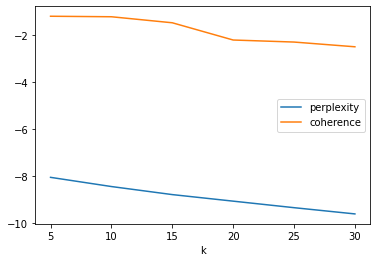

In [54]:
result = []
for k in [5, 10, 15, 20, 25, 30]:
  m = LdaModel(mm,num_topics=k,id2word=id2word, 
          random_state=123, alpha="auto")
  perplexity = m.log_perplexity(mm)
  coherence=CoherenceModel(model=m,corpus=mm,
      coherence="u_mass").get_coherence()
  result.append(dict(k=k, perplexity=perplexity, 
                     coherence=coherence))

result = pd.DataFrame(result)
result.plot(x="k", y=["perplexity", "coherence"])
plt.show()

From the perplexity and coherence plot we also can see a clear inflection point at k=20. However, after inspecting the visualization it seems better to try our hand using the tfidf vectorizer. By using the tdidf vectorizer we are transforming our text into a vector that on the basis of how many times the word occurs in the documents.

In [55]:
for k in NTOPICS:
    id2word_m2 = id2word
    ldacorpus_m2 = mm       
    tfidfcorpus_m2 = models.TfidfModel(ldacorpus_m2)
    mylda_m2 = models.ldamodel.LdaModel(corpus=tfidfcorpus_m2[ldacorpus_m2],id2word=id2word_m2,num_topics=k, passes=10)
    print ("\nModel with ",k," topics results in the following words:\n\n")
    print (mylda_m2.print_topics(num_words=5))


Model with  3  topics results in the following words:


[(0, '0.000*"passin" + 0.000*"opp" + 0.000*"straighten" + 0.000*"dododo" + 0.000*"dolla"'), (1, '0.002*"know" + 0.002*"do" + 0.002*"shit" + 0.002*"fuck" + 0.002*"man"'), (2, '0.000*"en" + 0.000*"amb" + 0.000*"del" + 0.000*"giggle" + 0.000*"flacko"')]

Model with  5  topics results in the following words:


[(0, '0.001*"egg" + 0.001*"bonita" + 0.000*"applebum" + 0.000*"zen" + 0.000*"surprising"'), (1, '0.001*"advance" + 0.000*"dolla" + 0.000*"straighten" + 0.000*"quinton" + 0.000*"muthaphukkin"'), (2, '0.001*"dopeman" + 0.000*"eee" + 0.000*"downstroke" + 0.000*"biddy" + 0.000*"motivate"'), (3, '0.003*"know" + 0.003*"do" + 0.003*"shit" + 0.002*"fuck" + 0.002*"man"'), (4, '0.001*"passin" + 0.001*"sea" + 0.000*"amb" + 0.000*"en" + 0.000*"del"')]

Model with  7  topics results in the following words:


[(0, '0.001*"motivate" + 0.001*"biddy" + 0.001*"bind" + 0.000*"along" + 0.000*"buggin"'), (1, '0.001*"bonita" + 0.001*"u" + 0.001*"del

In [56]:
vis_data1 = gensimvis.prepare(mylda_m2, ldacorpus_m2, id2word_m2, mds= 'mmds')
pyLDAvis.display(vis_data1)

From the visualiztion we can see that there are now more non overlapping topics, which is great! Unfortunately, the topics still do not seem to be clear cut. Let's try tuning the parameters.

Let's plot the coherence and perplexity scores for this model. I will set the number of topics to 15 and the change up the alpha parameter to see how this affects our inflection point. 

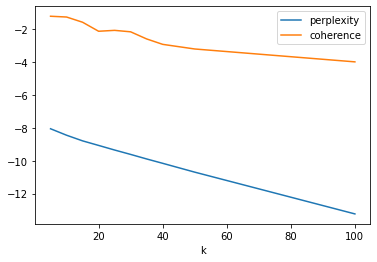

In [57]:
result = []
for k in [5, 10, 15, 20, 25, 30, 35, 40, 50, 100]:
  m = LdaModel(ldacorpus_m2, num_topics=k, id2word=id2word_m2,
  random_state=123, alpha="asymmetric")
  perplexity = m.log_perplexity(ldacorpus_m2)
  coherence=CoherenceModel(model=m,corpus=ldacorpus_m2,
  coherence="u_mass").get_coherence()
  result.append(dict(k=k, perplexity=perplexity, 
                     coherence=coherence))

result = pd.DataFrame(result)
result.plot(x="k", y=["perplexity", "coherence"])
plt.show()

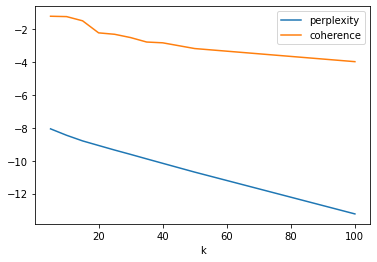

In [58]:
result = []
for k in [5, 10, 15, 20, 25, 30, 35, 40, 50, 100]:
  m = LdaModel(ldacorpus_m2, num_topics=k, id2word=id2word_m2,
  random_state=123, alpha="auto")
  perplexity = m.log_perplexity(ldacorpus_m2)
  coherence=CoherenceModel(model=m,corpus=ldacorpus_m2,
  coherence="u_mass").get_coherence()
  result.append(dict(k=k, perplexity=perplexity, 
                     coherence=coherence))

result = pd.DataFrame(result)
result.plot(x="k", y=["perplexity", "coherence"])
plt.show()

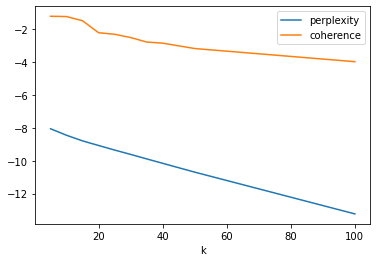

In [59]:
result = []
for k in [5, 10, 15, 20, 25, 30, 35, 40, 50, 100]:
  m = LdaModel(ldacorpus_m2, num_topics=k, id2word=id2word_m2,
  random_state=123, alpha="symmetric")
  perplexity = m.log_perplexity(ldacorpus_m2)
  coherence=CoherenceModel(model=m,corpus=ldacorpus_m2,
  coherence="u_mass").get_coherence()
  result.append(dict(k=k, perplexity=perplexity, 
                     coherence=coherence))

result = pd.DataFrame(result)
result.plot(x="k", y=["perplexity", "coherence"])
plt.show()

Changing the alpha parameter did not change the outcome by a lot. Let's therefore try running a model with 15 topics and the alpha set to auto.

In [60]:
Topics20 = 20

In [61]:
id2word_m2T = id2word
ldacorpus_m2T = mm       
tfidfcorpus_m2T = models.TfidfModel(ldacorpus_m2T)
mylda_m2T = models.ldamodel.LdaModel(corpus=tfidfcorpus_m2T[ldacorpus_m2T],id2word=id2word_m2T,num_topics=Topics20, passes=10, alpha='auto')
print ("\nTuned Model with 20 topics results in the following words:\n\n")
print (mylda_m2T.print_topics(num_words=10))


Tuned Model with 20 topics results in the following words:


[(0, '0.002*"motivate" + 0.002*"along" + 0.001*"buckin" + 0.001*"justice" + 0.001*"citycity" + 0.001*"platter" + 0.001*"please" + 0.001*"horny" + 0.001*"buzz" + 0.001*"dump"'), (1, '0.005*"geto" + 0.003*"violence" + 0.003*"nappy" + 0.002*"vocab" + 0.002*"cleveland" + 0.002*"perfection" + 0.002*"hollywood" + 0.002*"afro" + 0.002*"claim" + 0.002*"chevy"'), (2, '0.004*"low" + 0.004*"fake" + 0.004*"easy" + 0.003*"hop" + 0.003*"cmon" + 0.003*"thought" + 0.003*"business" + 0.003*"gangsta" + 0.003*"lady" + 0.003*"push"'), (3, '0.003*"food" + 0.002*"storm" + 0.002*"admit" + 0.002*"plug" + 0.002*"camp" + 0.002*"flight" + 0.002*"naughty" + 0.002*"science" + 0.002*"woo" + 0.002*"anywhere"'), (4, '0.002*"outkast" + 0.002*"ego" + 0.001*"enjoy" + 0.001*"solid" + 0.001*"carter" + 0.001*"rid" + 0.001*"gal" + 0.001*"lunatic" + 0.001*"hustla" + 0.001*"hooker"'), (5, '0.003*"dopeman" + 0.001*"tempo" + 0.001*"potato" + 0.001*"galore" + 0.001*"h

Running the model does not seem to give us a good indication of topics. Topic 5 could be about the most mentioned areas in rap songs, namely bronx in New York and compton in south central Los Angeles with the words 'brookly', 'bronx', 'compton' and 'south'.

In [62]:
vis_data1T = gensimvis.prepare(mylda_m2T, ldacorpus_m2T, id2word_m2T, mds= 'mmds')
pyLDAvis.display(vis_data1T)

Next, let's try making some bigrams. 

In [63]:
#https://github.com/wjbmattingly/topic_modeling_textbook/blob/main/03_03_lda_model_demo_bigrams_trigrams.ipynb
def gen_words(texts):
    final = []
    for text in texts:
        new = gensim.utils.simple_preprocess(text, deacc=True)
        final.append(new)
    return (final)

data_words = gen_words(data_lemma)

print (data_words[0][0:20])

['beginnin', 'feel', 'rap', 'god', 'rap', 'people', 'front', 'nod', 'back', 'nod', 'way', 'racin', 'track', 'call', 'nascar', 'nascar', 'dale', 'earnhardt', 'trailer', 'park']


In [64]:
# Create a dictionary representation of the documents.
dictionary = Dictionary(data_words)

# Filter out words that occur less than 20 documents, or more than 50% of the documents.
dictionary.filter_extremes(no_below=20, no_above=0.5)

In [65]:
#https://github.com/wjbmattingly/topic_modeling_textbook/blob/main/03_03_lda_model_demo_bigrams_trigrams.ipynb
#Bigrams and trigrams
bigram_phrases = gensim.models.Phrases(data_words, min_count=5, threshold=100)
trigram_phrases = gensim.models.Phrases(bigram_phrases[data_words], threshold=100)

bigram = gensim.models.phrases.Phraser(bigram_phrases)
trigram = gensim.models.phrases.Phraser(trigram_phrases)

def make_bigrams(texts):
    return([bigram[doc] for doc in texts])

def make_trigrams(texts):
    return ([trigram[bigram[doc]] for doc in texts])

data_bigrams = make_bigrams(data_words)
data_bigrams_trigrams = make_trigrams(data_bigrams)



In [66]:
print ('Model 3: Controlling for bigrams and trigrams)')
id2word_m3 = corpora.Dictionary(data_bigrams_trigrams)                       
ldacorpus_m3 = [id2word_m3.doc2bow(doc) for doc in data_bigrams_trigrams]
tfidfcorpus_m3 = models.TfidfModel(ldacorpus_m3)
lda_m3 = models.ldamodel.LdaModel(corpus=tfidfcorpus_m3[ldacorpus_m3],id2word=id2word_m3,num_topics=30, passes = 10, alpha='auto', eta='auto')
lda_m3.print_topics(num_words=10)

Model 3: Controlling for bigrams and trigrams)


[(5,
  '0.002*"mafuckin" + 0.001*"ohhhh" + 0.001*"pray_pray" + 0.001*"dodododo" + 0.001*"fresher" + 0.001*"boogieman" + 0.001*"bend_lift" + 0.001*"fuckin_ridiculous" + 0.001*"snoopy_dogg" + 0.001*"arab_money"'),
 (1,
  '0.002*"mellow" + 0.002*"protect_neck" + 0.002*"track_show_ruthless" + 0.002*"misery" + 0.002*"plug" + 0.001*"predict" + 0.001*"method" + 0.001*"ecstasy" + 0.001*"woahwoah" + 0.001*"disrespectful"'),
 (18,
  '0.003*"hand_air" + 0.003*"puff" + 0.001*"clog" + 0.001*"youyou" + 0.001*"roller" + 0.001*"french_inhale" + 0.001*"hunnid" + 0.001*"easy_easy" + 0.001*"breakdown" + 0.001*"fleece"'),
 (6,
  '0.004*"alright" + 0.003*"bonita_applebum" + 0.002*"incredible" + 0.001*"yknahmean" + 0.001*"manifest" + 0.001*"woah_woah" + 0.001*"latin" + 0.001*"amazed" + 0.001*"hotel_room" + 0.001*"bone_biggie_biggie"'),
 (17,
  '0.003*"help_help" + 0.002*"murda" + 0.002*"tempo" + 0.002*"deny" + 0.002*"dust_dust" + 0.001*"envy" + 0.001*"jackson" + 0.001*"dopeman_dopeman" + 0.001*"ughugh" + 0.

In [67]:
vis_data2 = gensimvis.prepare(lda_m3, ldacorpus_m3, id2word_m3, mds= 'mmds')
pyLDAvis.display(vis_data2)

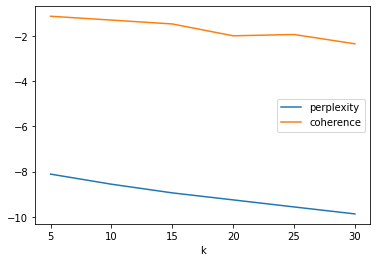

In [68]:
result = []
for k in [5, 10, 15, 20, 25, 30]:
  m = LdaModel(ldacorpus_m3, num_topics=k, id2word=id2word_m3,
  random_state=123, alpha="symmetric")
  perplexity = m.log_perplexity(ldacorpus_m3)
  coherence=CoherenceModel(model=m,corpus=ldacorpus_m3,
  coherence="u_mass").get_coherence()
  result.append(dict(k=k, perplexity=perplexity, 
                     coherence=coherence))

result = pd.DataFrame(result)
result.plot(x="k", y=["perplexity", "coherence"])
plt.show()

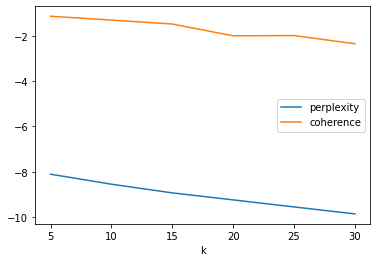

In [69]:
result = []
for k in [5, 10, 15, 20, 25, 30]:
  m = LdaModel(ldacorpus_m3, num_topics=k, id2word=id2word_m3,
  random_state=123, alpha="auto")
  perplexity = m.log_perplexity(ldacorpus_m3)
  coherence=CoherenceModel(model=m,corpus=ldacorpus_m3,
  coherence="u_mass").get_coherence()
  result.append(dict(k=k, perplexity=perplexity, 
                     coherence=coherence))

result = pd.DataFrame(result)
result.plot(x="k", y=["perplexity", "coherence"])
plt.show()

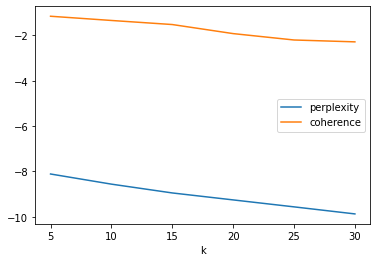

In [70]:
result = []
for k in [5, 10, 15, 20, 25, 30]:
  m = LdaModel(ldacorpus_m3, num_topics=k, id2word=id2word_m3,
  random_state=123, alpha="asymmetric")
  perplexity = m.log_perplexity(ldacorpus_m3)
  coherence=CoherenceModel(model=m,corpus=ldacorpus_m3,
  coherence="u_mass").get_coherence()
  result.append(dict(k=k, perplexity=perplexity, 
                     coherence=coherence))

result = pd.DataFrame(result)
result.plot(x="k", y=["perplexity", "coherence"])
plt.show()

In [73]:
print ('Tuned Model 3: Controlling for bigrams and trigrams)')
id2word_m3T = corpora.Dictionary(data_bigrams_trigrams)                       
ldacorpus_m3T = [id2word_m3T.doc2bow(doc) for doc in data_bigrams_trigrams]
tfidfcorpus_m3T = models.TfidfModel(ldacorpus_m3T)
lda_m3T = models.ldamodel.LdaModel(corpus=tfidfcorpus_m3T[ldacorpus_m3T],id2word=id2word_m3T,num_topics=15, alpha='auto', eta='auto')
lda_m3T.print_topics(num_words=5)

Tuned Model 3: Controlling for bigrams and trigrams)


[(0,
  '0.002*"way" + 0.002*"know" + 0.001*"oooh" + 0.001*"fuck" + 0.001*"real"'),
 (1, '0.003*"do" + 0.003*"know" + 0.003*"bitch" + 0.003*"man" + 0.003*"fuck"'),
 (2,
  '0.003*"want" + 0.003*"do" + 0.002*"time" + 0.002*"shit" + 0.002*"world"'),
 (3,
  '0.001*"tonight" + 0.001*"know" + 0.001*"bboy" + 0.001*"re" + 0.001*"punk"'),
 (4,
  '0.002*"baby" + 0.002*"go" + 0.002*"rhythm" + 0.002*"cause" + 0.002*"know"'),
 (5,
  '0.002*"shit" + 0.002*"ill" + 0.002*"da" + 0.002*"gangsta" + 0.002*"smoke"'),
 (6,
  '0.001*"emcee" + 0.001*"motherfuckin" + 0.001*"battle" + 0.001*"outkast" + 0.001*"life"'),
 (7, '0.002*"rock" + 0.001*"fuck" + 0.001*"ai" + 0.001*"shit" + 0.001*"new"'),
 (8,
  '0.001*"naughty" + 0.001*"muhammad" + 0.001*"man" + 0.001*"do" + 0.001*"want"'),
 (9,
  '0.002*"fish_sea" + 0.001*"know" + 0.001*"hold" + 0.001*"fair" + 0.001*"faith"'),
 (10,
  '0.002*"go" + 0.002*"fuck" + 0.002*"muthafuckin" + 0.001*"thang" + 0.001*"want"'),
 (11,
  '0.002*"clap" + 0.002*"money" + 0.002*"well" +

In [72]:
vis_data2T = gensimvis.prepare(lda_m3T, ldacorpus_m3T, id2word_m3T, mds= 'mmds')
pyLDAvis.display(vis_data2T)

# Results 

Running the LDA topic model on up to 100 topics with the count vectorizer did not provide this analysis with any very good results. In fact, most of the words were not particularly good at harmonizing any topics. There was also a lot of overlap between the topics. Before running further topic modelling analysis. I went back to further customize the stop word list to exclude words that do not give much meaning in order to create a model with words that harmonize given topic more. Running the LDA model with the TfIdf vectorizer provided some slightly more promising insights. The metrics showed the weight of all words being much less than in the model using the count vectorizer. However, a lot of the topis were still largely overlapping. From topic 15 upwards there still seemed to be a lot of overlap. After tuning the alpha hyperparameter the perplexity and coherence scores indicated the inflection point at k=20 topics. As such as model was run with the number of topics at k=20 and the alpha set to auto and the passes parameter was set to 10. After the tuning of the hyperparameter there were 2 non over lapping topics with that made sense as seen on the visualization (vis_data1T). 

Topic 2 = Topic about money, keywords: Money, dollar, bill, business, job

Topic 6 = Topic about violence, keywords: Violent, violence, ghetto

Yet, the rest of the topics did unfortunately not produce anything coherent. Next, bigrams and trigrams were introduced that somewhat successfully combined words such as ‘new’ and ‘york’ to make ‘New York’. However, by manually inspecting the metrics there not many other meaning combinations could be spotted. I still decided to plot the coherence and perplexity scores in the hope of improving the output of the model. The number of topics to be looked for ranged from 5 to 30 and with varying alpha values. After tuning these hyperparameters a final model was run on the data with bigrams and trigrams, number of topics at k=15 and the alpha and eta parameters set to auto. Unfortunately, it can be concluded here that these configurations with the data made into bigrams also does has not led to produce any coherent topics. Words on topic 3 on the untuned model on the visualization perhaps somewhat weakly loaded on the topic of ‘crime’ by containing the words ‘law’, ‘murder’ and ‘bullet’.  Topic 3 also included the word ‘New_York’ and ‘bronx’ indicating that perhaps a lot of documents in the corpus were about crime in New York. 



# Sources

Ballard, M. E., Dodson, A. R., & Bazzini, D. G. (1999). Genre of music and lyrical content: Expectation effects. The Journal of Genetic Psychology, 160(4), 476-487. 

    
Barradas, G. T., & Sakka, L. S. (2021). When words matter: A cross-cultural perspective on lyrics and their relationship to musical emotions. Psychology of Music, 03057356211013390. 


Blackman, S. (2014). Subculture theory: An historical and contemporary assessment of the concept for understanding deviance. Deviant behavior, 35(6), 496-512. 


Calvert, C., Morehart, E., & Papdelias, S. (2014). Rap music and the true threats quagmire: When does one man's lyric become another's crime. Colum. JL & Arts, 38, 1. 


Dunbar, A. (2019). Rap music, race, and perceptions of crime. Sociology Compass, 13(10), e12732. 


Kubrin, C. E. (2005). “I see death around the corner”: Nihilism in rap music. Sociological Perspectives, 48(4), 433-459. 


Lena, J. C. (2006). Social context and musical content of rap music, 1979–1995. Social Forces, 85(1), 479-495. 


MacDonald, R., Kreutz, G., & Mitchell, L. (2012). What is music, health, and wellbeing and why is it important. Music, health, and wellbeing, 3-11 


Maier, D., Waldherr, A., Miltner, P., Wiedemann, G., Niekler, A., Keinert, A., ... & Adam, S. (2018). Applying LDA topic modeling in communication research: Toward a valid and reliable methodology. Communication Methods and Measures, 12(2-3), 93-118. 


Mimno, D., Wallach, H., Talley, E., Leenders, M., & McCallum, A. (2011, July). Optimizing semantic coherence in topic models. In Proceedings of the 2011 conference on empirical methods in natural language processing (pp. 262-272). 


North, A. C., Hargreaves, D. J., & O'Neill, S. A. (2000). The importance of music to adolescents. British journal of educational psychology, 70(2), 255-272. 


Rothbaum, F., & Tsang, B. Y. P. (1998). Lovesongs in the United States and China: On the nature of romantic love. Journal of Cross-Cultural Psychology, 29(2), 306-319. 


Stratton, V. N., & Zalanowski, A. H. (1994). Affective impact of music vs. lyrics. Empirical studies of the arts, 12(2), 173-184. 


Tyson, E. H. (2002). Hip hop therapy: An exploratory study of a rap music intervention with at-risk and delinquent youth. Journal of Poetry Therapy, 15(3), 131-144. 


van Atteveldt, W., Trilling, D., and Arc ́ıla Calder ́on, C. (2022). Computational Analysis of Communication: A Practical Introduction to the Analysis of Texts, Networks, and Images with Code Examples in Python and R. Wiley, Hoboken, NJ. 
 
